<a href="https://colab.research.google.com/github/Ali-mohammadi-design/Numpy_Stack/blob/main/Scipy_Filter.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import numpy as np

In [11]:
Hx=np.array([[1,0,-1],[2,0,-2],[1,0,-1]])
Hy=np.array([[1,2,1],[0,0,0],[-1,-2,-1]])

In [13]:
Hx

array([[ 1,  0, -1],
       [ 2,  0, -2],
       [ 1,  0, -1]])

In [14]:
Hy

array([[ 1,  2,  1],
       [ 0,  0,  0],
       [-1, -2, -1]])

In [23]:
from google.colab import files
uploaded = files.upload()

Saving IMG_20230217_121316_1.jpg to IMG_20230217_121316_1.jpg


In [24]:
from PIL import Image
import io

# Load the uploaded file
image_name = list(uploaded.keys())[0]
image = Image.open(image_name)
image.show()

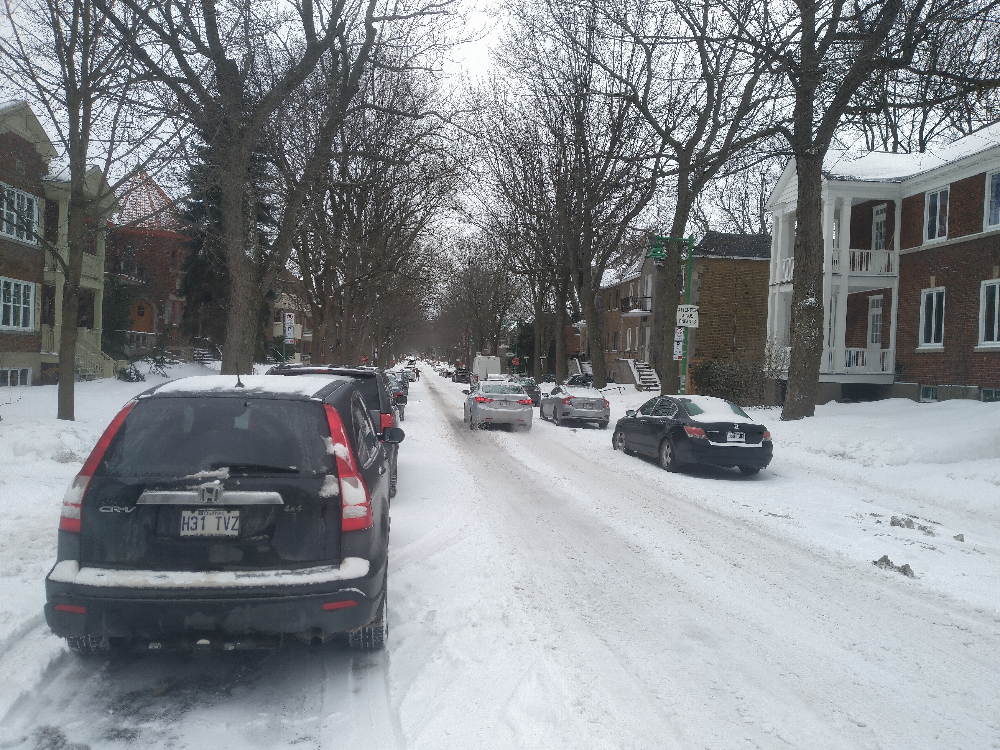

In [25]:
from IPython.display import display
display(image)


In [26]:
type(image)

PIL.JpegImagePlugin.JpegImageFile

In [27]:
# Convert PIL image to NumPy array
image_array = np.array(image)

# Now you can print or check its shape
print(image_array.shape)

(3456, 4608, 3)


In [28]:
Hx*image_array

ValueError: operands could not be broadcast together with shapes (3,3) (3456,4608,3) 

In [29]:
gray=np.mean(image_array, axis=2)

In [32]:
import matplotlib.pyplot as plt

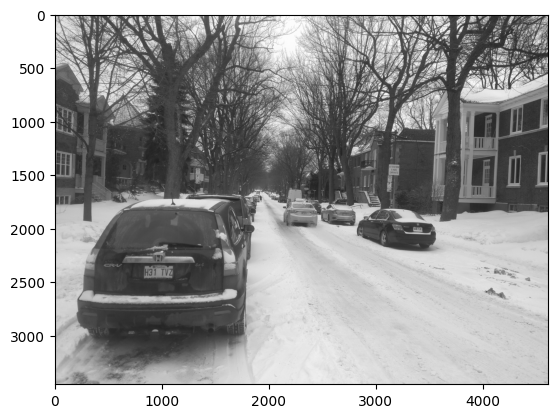

In [33]:
plt.imshow(gray, cmap='gray')

In [34]:
from scipy.signal import convolve2d

In [43]:
out = convolve2d(gray, Hx, mode='same')  # use mode='same' to keep size

In [44]:
# Normalize output to 0–255 range for better visibility
out_normalized = np.clip(out, 0, 255).astype(np.uint8)

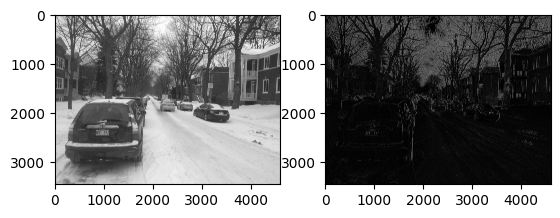

In [45]:
plt.subplot(1,2,1)
plt.imshow(gray, cmap='gray')
plt.subplot(1,2,2)
plt.imshow(out_normalized, cmap='gray')

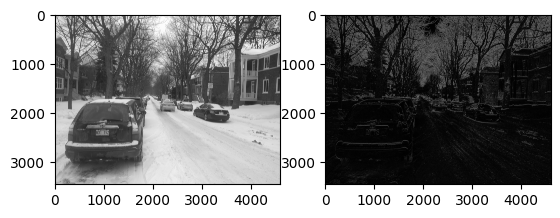

In [46]:
out_y = convolve2d(gray, Hy, mode='same')
out_y_normalized = np.clip(out_y, 0, 255).astype(np.uint8)
plt.subplot(1,2,1)
plt.imshow(gray, cmap='gray')
plt.subplot(1,2,2)
plt.imshow(out_y_normalized, cmap='gray')

In [48]:
G=np.sqrt(out_normalized**2+out_y_normalized**2)

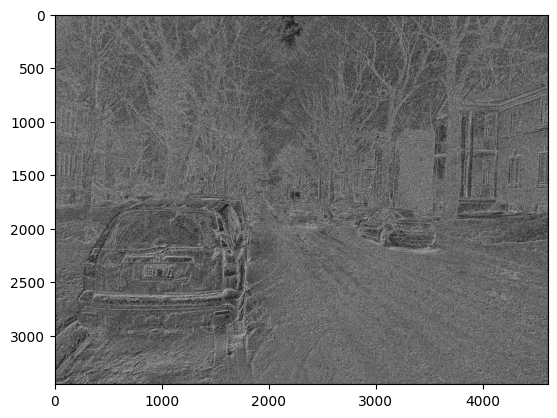

In [49]:
plt.imshow(G, cmap='gray')